# Single Qubit Operations and Circuits using Qiskit

In [132]:
%matplotlib inline
# Importing standard Qiskit libraries and configuring account
from qiskit import QuantumCircuit, execute, Aer, IBMQ
from qiskit.compiler import transpile, assemble
from qiskit.providers.aer import QasmSimulator
from qiskit.providers.ibmq import least_busy
from qiskit.tools.jupyter import *
from qiskit.visualization import *
from qiskit.quantum_info import *
import numpy as np
import matplotlib.pyplot as plt
# Loading your IBM Q account(s)
provider = IBMQ.load_account()

ibmqfactory.load_account:WARNING:2020-09-13 15:21:21,751: Credentials are already in use. The existing account in the session will be replaced.


## Statevectors in Qiskit
Qiskit allows us to construct and manipulate statevectors directly. We can construct statevectors from the basis states.

In [19]:
q1_sv = Statevector.from_label('+') # Available basis states are 0, 1, +, -, l, r
print(q1_sv)

Statevector([0.70710678+0.j, 0.70710678+0.j],
            dims=(2,))


In [20]:
q1_sv.is_valid()

True

In [21]:
q1_sv.probabilities_dict()

{'0': 0.4999999999999999, '1': 0.4999999999999999}

In [72]:
q1_sv.measure()

('1',
 Statevector([0.+0.j, 1.+0.j],
             dims=(2,)))

In [71]:
measured_values = [int(q1_sv.measure()[0]) for _ in range(1000)]
# print(measured_values)
print(f'Number of 0 measured: {measured_values.count(0)}, Number of 1 measured: {measured_values.count(1)}')

Number of 0 measured: 504, Number of 1 measured: 496


### Bloch Sphere Visualisation of Statevectors

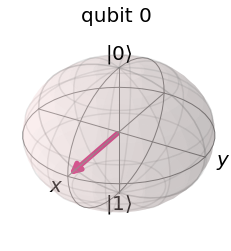

In [75]:
q1_sv = Statevector.from_label('+') # Available basis states are 0, 1, +, -, l, r
plot_bloch_multivector(q1_sv)

## Operators in Qiskit

In [83]:
op1 = Operator.from_label('X') # I, X, Y, Z, S, T, H
print(op1.data)
op1.is_unitary()

[[0.+0.j 1.+0.j]
 [1.+0.j 0.+0.j]]


True

In [84]:
op1.adjoint()

Operator([[0.-0.j, 1.-0.j],
          [1.-0.j, 0.-0.j]],
         input_dims=(2,), output_dims=(2,))

### Applying Operators on Statevectors

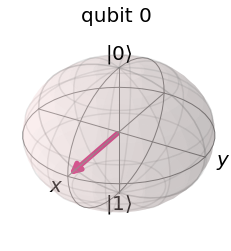

In [103]:
q2_sv = Statevector.from_label('+')
plot_bloch_multivector(q2_sv)

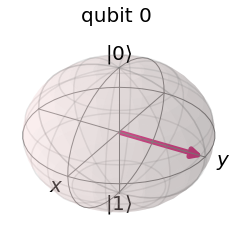

In [104]:
op1 = Operator.from_label('S')
q2_sv = q2_sv.evolve(op1)
plot_bloch_multivector(q2_sv)

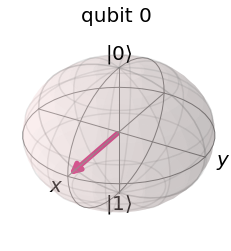

In [105]:
op2 = Operator.from_label('S')
q2_sv = q2_sv.evolve(op2.adjoint())
plot_bloch_multivector(q2_sv)

### Effect of Single qubit transformations on various basis states
> Using only the Pauli-gates it is impossible to move our initialised qubit to any state other than |0⟩ or |1⟩, i.e. we cannot achieve superposition. This means we can see no behaviour different to that of a classical bit. To create more interesting states we will need more gates! 

(from [Learn Quantum Computation using Qiskit](https://qiskit.org/textbook/preface.html))

![Image of Yaktocat](./img/op_bloch.png)

## Circuit model of Quantum Computing

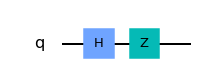

In [112]:
qc = QuantumCircuit(1)
qc.h(0)
qc.z(0)
qc.draw(output='mpl')

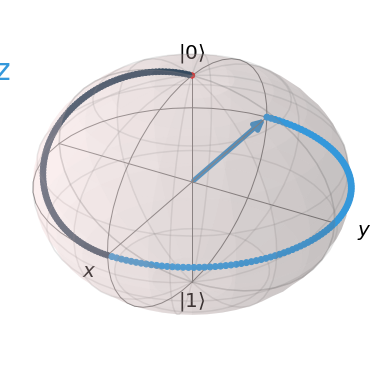

In [108]:
visualize_transition(qc, trace=True)

### Measurements and running experiments

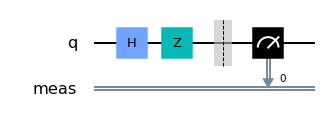

In [116]:
qc.measure_all()
qc.draw(output='mpl')

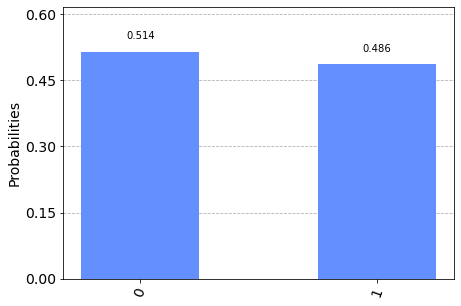

In [126]:
job = execute(qc, backend=QasmSimulator(), shots=1024)
plot_histogram(job.result().get_counts())